Following the tutorial on https://blog.paperspace.com/introduction-to-audio-analysis-and-synthesis/

In [1]:
import librosa
import numpy as np
from matplotlib import pyplot as plt
import librosa.display

In [2]:
x, sampling_rate = librosa.load('./input/Hoppipolla.mp3', sr=None)

/home/portugapt/.pyenv/versions/3.8.1/envs/LearnHub/lib/python3.8/site-packages/librosa/core/audio.py:165: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


Sampling Rate:  44100


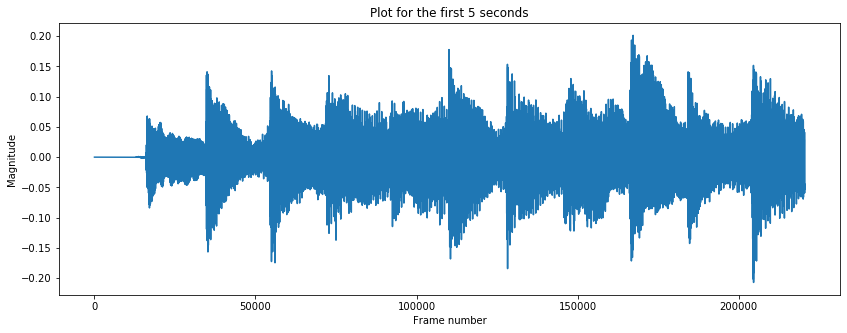

In [3]:
print('Sampling Rate: ', sampling_rate)
plt.figure(figsize=(14, 5))
plt.plot(x[:sampling_rate * 5])
plt.title('Plot for the first 5 seconds')
plt.xlabel('Frame number')
plt.ylabel('Magnitude')
plt.show()

Passing a null value in the sampling ratio argument returns the file loaded with the native sampling ratio. 

In [4]:
print('Sampling Rate: ', sampling_rate)

Sampling Rate:  44100


In [5]:
import IPython.display as ipd

ipd.Audio(x, rate=sampling_rate)

In [5]:
print('sampling rate: ', sampling_rate)
duration = librosa.get_duration(x)
print('duration: ', duration)

sampling rate:  44100
duration:  538.0992290249433


In [7]:
S = librosa.stft(x)

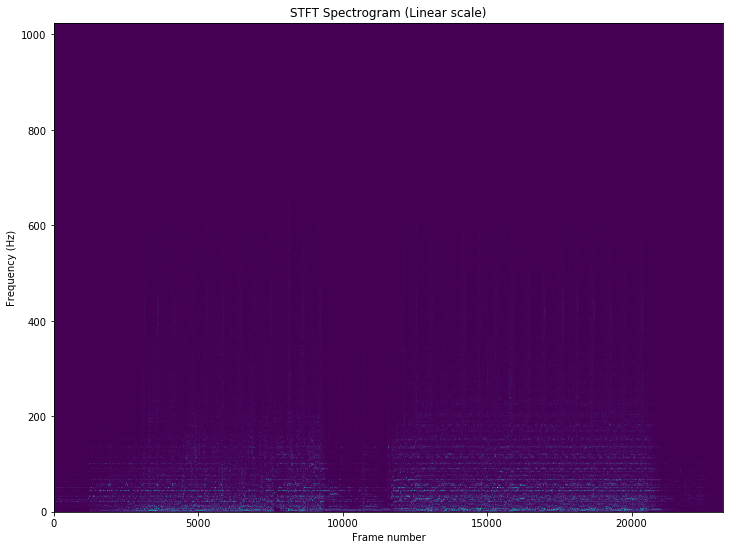

In [6]:
from matplotlib import pyplot as plt

fig = plt.figure(figsize=(12,9))
plt.title('STFT Spectrogram (Linear scale)')
plt.xlabel('Frame number')
plt.ylabel('Frequency (Hz)')
plt.pcolormesh(np.abs(S))
plt.savefig('stft-plt.png')

/home/portugapt/.pyenv/versions/3.8.1/envs/LearnHub/lib/python3.8/site-packages/librosa/display.py:954: UserWarning: Trying to display complex-valued input. Showing magnitude instead.
  warnings.warn(


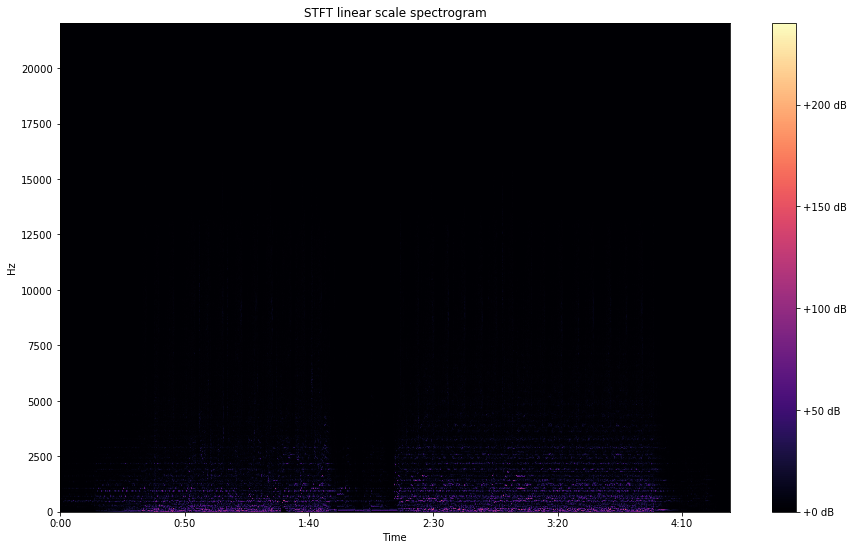

In [7]:

fig, ax = plt.subplots(figsize=(15,9))
img = librosa.display.specshow(S, x_axis='time',
                         y_axis='linear', sr=sampling_rate,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='STFT linear scale spectrogram')
plt.savefig('stft-librosa-linear.png')

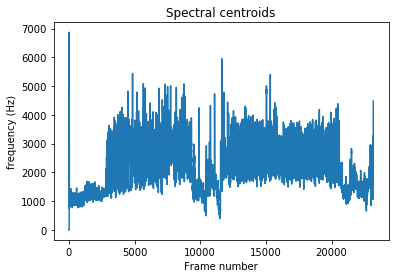

In [6]:
plt.plot(librosa.feature.spectral_centroid(x, sr=sampling_rate)[0])
plt.xlabel('Frame number')
plt.ylabel('frequency (Hz)')
plt.title('Spectral centroids')
plt.show()

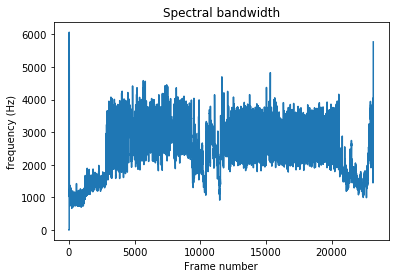

In [5]:
spec_bw = librosa.feature.spectral_bandwidth(x, sr=sampling_rate)
plt.plot(spec_bw[0])
plt.xlabel('Frame number')
plt.ylabel('frequency (Hz)')
plt.title('Spectral bandwidth')
plt.show()

http://man.hubwiz.com/docset/LibROSA.docset/Contents/Resources/Documents/generated/librosa.core.stft.html#librosa.core.stft

In [6]:
S = librosa.stft(x)
spec_bw = librosa.feature.spectral_bandwidth(x, sr=sampling_rate)
times = librosa.times_like(spec_bw)

/home/portugapt/.pyenv/versions/3.8.1/envs/LearnHub/lib/python3.8/site-packages/librosa/core/spectrum.py:1641: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  warnings.warn(
/home/portugapt/.pyenv/versions/3.8.1/envs/LearnHub/lib/python3.8/site-packages/librosa/display.py:954: UserWarning: Trying to display complex-valued input. Showing magnitude instead.
  warnings.warn(


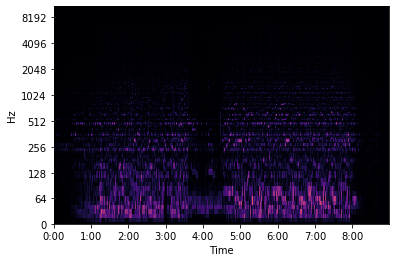

In [17]:
S_db2 = librosa.amplitude_to_db(S, ref=np.max)
S_dB = librosa.display.specshow(S,y_axis='log', x_axis='time')

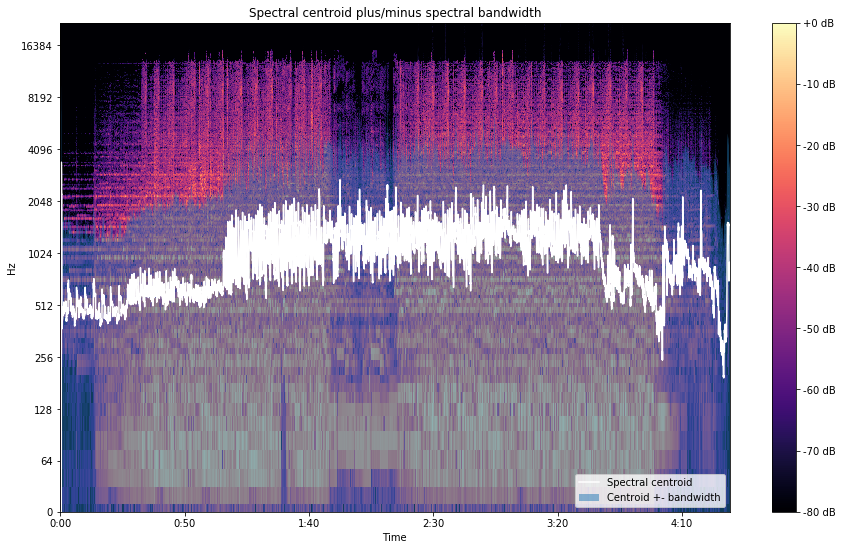

In [9]:
S = librosa.stft(x)
spec_bw = librosa.feature.spectral_bandwidth(x, sr=sampling_rate)
times = librosa.times_like(spec_bw)
S_dB = librosa.amplitude_to_db(S, ref=np.max)

centroid = librosa.feature.spectral_centroid(S=np.abs(S))

fig, ax = plt.subplots(figsize=(15,9))
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='log', sr=sampling_rate,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Spectral centroid plus/minus spectral bandwidth')
ax.fill_between(times, centroid[0] - spec_bw[0], centroid[0] + spec_bw[0],
                alpha=0.5, label='Centroid +- bandwidth')
ax.plot(times, centroid[0], label='Spectral centroid', color='w')
ax.legend(loc='lower right')
plt.savefig('centroid-vs-bw-librosa.png')

# Spectral Features

## Amplitude Spectrum 

In [11]:
S = librosa.stft(x)

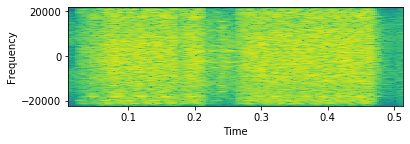

In [10]:
import numpy as np
from scipy import signal
import matplotlib.pyplot as plt


plt.figure(1)
c = plt.subplot(211)
Pxx, freqs, bins, im = c.specgram(S, NFFT=1024, Fs=44100, noverlap=900)
c.set_xlabel('Time')
c.set_ylabel('Frequency')
plt.show()